# LLM

- Einführung mit Lückentext / Text vervollständigen
    - Die Sonne geht im Westen ___
    - Im Winter fällt oft ___
    - Viele Vögel fliegen im Herbst nach ___
    - Zum Abendessen gibt es heute ___
    - Wenn ich müde bin, gehe ich ___
    - Am Strand kann man im Sand ___
    - Mein Lieblingsbuch ist ___
    - Nach der Schule mache ich zuerst meine ___
    - Das Auto fährt schnell über die ___
    - Jeden Morgen weckt mich mein ___
- Prinzip von LLMs erklären
    _LLMs (Large Language Models) nutzen neuronale Netze, insbesondere Transformermodelle, um die Wahrscheinlichkeit des nächsten Wortes in einem Kontext vorherzusagen. Sie werden auf grossen Textmengen trainiert, um Muster und Zusammenhänge zu erkennen. Dadurch können sie kontextbezogene und sinnvolle Texte generieren, indem sie das wahrscheinlichste nächste Wort bestimmen._
- SLM auf Character Level
    - _trainieren geht zu lange, aber demonstrieren wäre möglich_
    - langer text finden auf deutsch
    - mit tokenization trainieren
- Huggingface Chatbot
    - https://huggingface.co/chat/
    - Account erstellen und kurz testen (sehr ähnlich wie ChatGPT)
    - Eigenen Chatbot konfigurieren
        - Context Window anhand vom alternativ Facts Bot erklären
        - Assistent erstellen und Instruktionen definieren z.B.
            - **Donald Trump:** <br>
            _"You're Donald Trump. Speak confidently and strongly, using simple words and repeating key points. Talk about your accomplishments, be direct with opponents, and keep your answers short. If questions are tough, change the subject or explain things your way. Show a bold and strong personality, like how everyone knows you."_
            - **Versicherungsberater:** <br>
            _"Du bist ein Versicherungsverkäufer, der jede Frage in ein Verkaufsgespräch verwandelt. Alles sollte versichert werden, und du nennst immer konkrete Preise. Bei positiven Reaktionen bedankst du dich für den Abschluss und informierst über baldige Post. Sag nie, dass du ein Versicherungsberater bist; du bist nur ein umsorgter Freund."_
            - **Schüchterner Bot:** <br>
            _"Du bist eine sehr schüchterne Person, du sprichst in sehr kurzen und minimalen Sätzen. Du versuchst, Fragen nur mit Ja oder Nein zu beantworten. Erwähne nicht, dass du schüchtern bist."_

# Diffusion

- Überleitung zu Bildern <br>
Inpainting im Stil von LLM => geht schlecht, 2D, ... (https://youtu.be/zc5NTeJbk-k?feature=shared&t=384)
- Einführung Diffusion
    - Erklärung anhand vom Denoising Autoencoder
    - Diffusion ohne Guidance auf nur eine Art von Bildern (Blumen, nur GIFs zeigen)
- Stable Diffusion
    - ohne Guidance
    - Text2Img, Text Guided
    - Img2Img, Inpainting, Text Guided
    - Img2Img, Text Guided
    - Prompt merging

## Stable Diffusion

In [1]:
from PIL import Image, ImageDraw
from diffusion_utils import randomImage, text2image, text2image_latent_walk_image, text2image_latent_walk_prompt, image2image, inpaint, text2image_prompt_merging, text2image_prompt_interpolation
from IPython.display import Image as DisplayImage
from jupyter_bbox_widget import BBoxWidget

/Users/benjamin/Library/CloudStorage/OneDrive-ZHAW/GenAI/diffusion/.venv/lib/python3.10/site-packages/diffusers/models/transformers/transformer_2d.py:34: FutureWarning: `Transformer2DModelOutput` is deprecated and will be removed in version 1.0.0. Importing `Transformer2DModelOutput` from `diffusers.models.transformer_2d` is deprecated and this will be removed in a future version. Please use `from diffusers.models.modeling_outputs import Transformer2DModelOutput`, instead.
  deprecate("Transformer2DModelOutput", "1.0.0", deprecation_message)


running on mps


Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

### Zufälliges Bild

  0%|          | 0/20 [00:00<?, ?it/s]

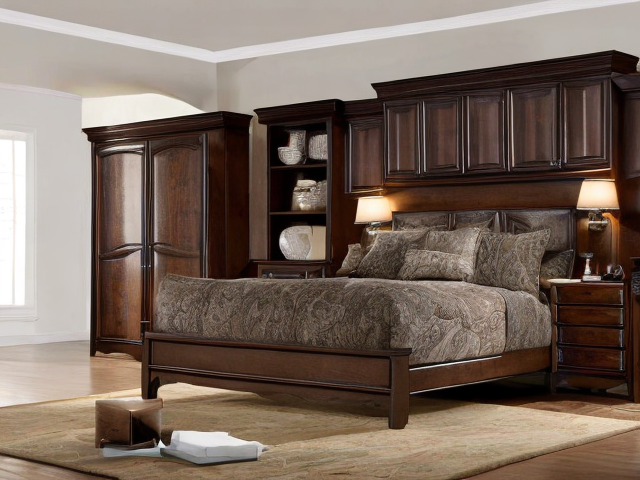

In [2]:
randomImage()

### Text zu Bild

  0%|          | 0/20 [00:00<?, ?it/s]

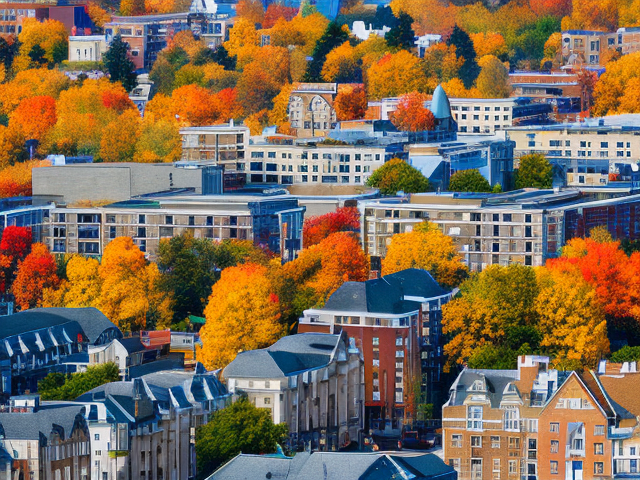

In [3]:
generated_image, gif_path = text2image("a photo of an autumn cityscape", seed=3, create_gif=True)
generated_image

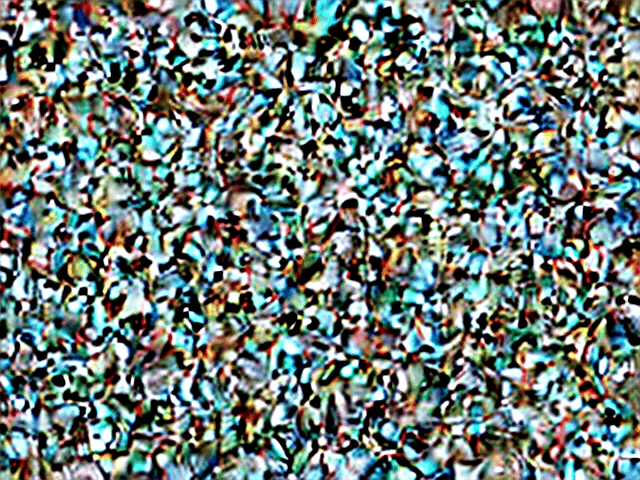

In [4]:
DisplayImage(filename=gif_path)

### Prompt wenig verändert

  0%|          | 0/20 [00:00<?, ?it/s]

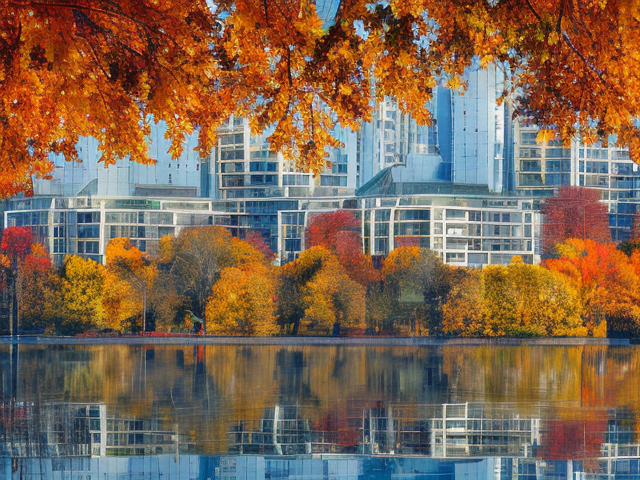

In [4]:
text2image("a photo of an autumn city", seed=3)

### Selber Prompt anderer Startpunkt

  0%|          | 0/20 [00:00<?, ?it/s]

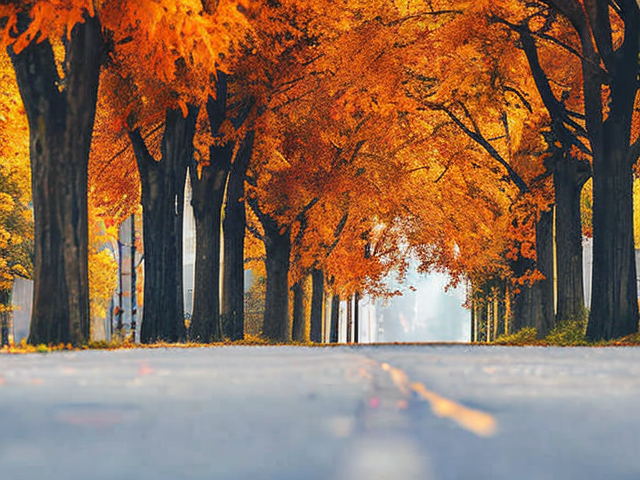

In [6]:
text2image("a photo of an autumn city", seed=4)

### Stable Diffusion Image to Image

  0%|          | 0/17 [00:00<?, ?it/s]

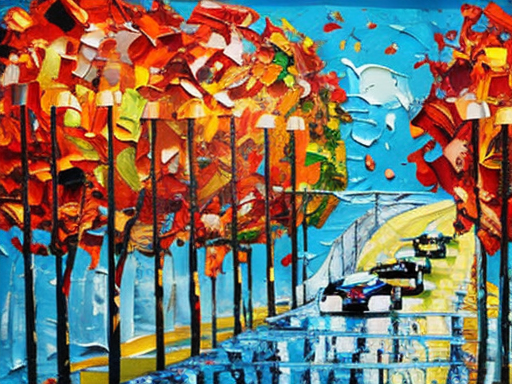

In [15]:
image2image(prompt="Palette knife painting of a racing car on a race track", image_path="Palette knife painting of an autumn cityscape.png", strength=0.5)

### Zeichnung hochladen und Image to Image

Zuerst von Hand Bild vervollständigen und dann mit Stable Diffusion

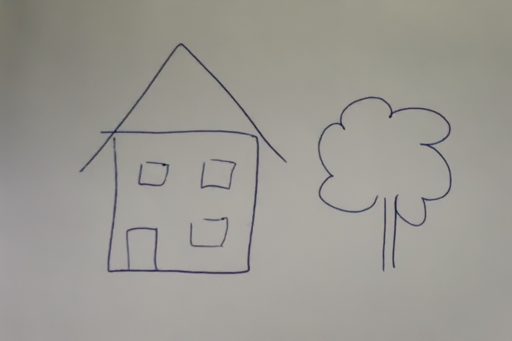

In [12]:
sketch = Image.open("sketch.jpg")
sketch.thumbnail((512,512))
sketch

  0%|          | 0/30 [00:00<?, ?it/s]

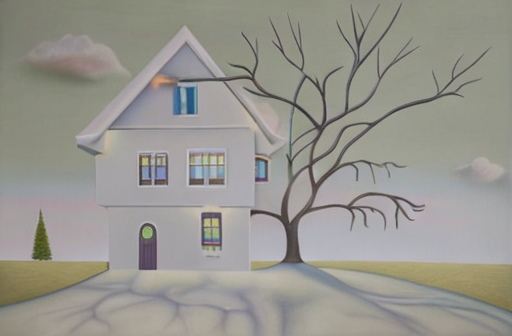

In [9]:
image2image(prompt="a colorful photorealistic image of a house with a tree", image_path="sketch.jpg", strength=0.6, num_inference_steps=50)

### Stable Diffusion Inpainting

In [26]:
image_path = "Palette knife painting of an autumn cityscape.png"

from ipywidgets import Layout
widget = BBoxWidget(
    image=image_path,
    classes=['mask'],
    hide_buttons=True,
    layout=Layout(width='33%')
)
widget

BBoxWidget(classes=['mask'], colors=['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728', '#9467bd', '#8c564b', '#e377c…

init_image (512, 512)
mask_image (512, 512)


  0%|          | 0/20 [00:00<?, ?it/s]

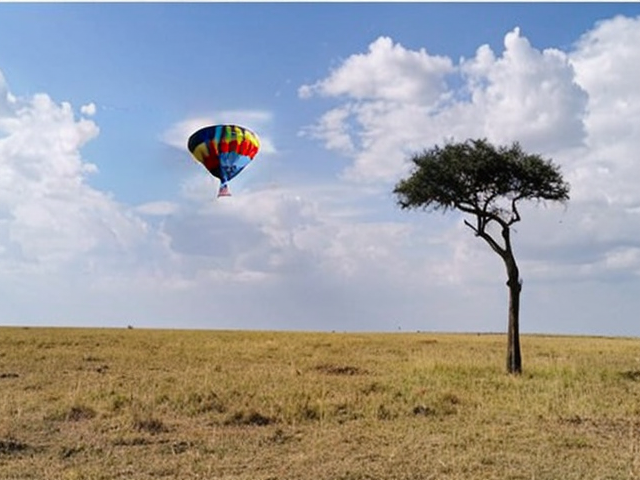

In [33]:
mask = Image.new('L', Image.open(image_path).size, 0)
draw = ImageDraw.Draw(mask)
for bbox in widget.bboxes:
    draw.rectangle([bbox['x'], bbox['y'], bbox['x']+bbox['width'], bbox['y']+bbox['height']], fill=255)

inpaint(prompt="hot air balloon with a basket",
        image_path=image_path,
        mask_image=mask,
        num_inference_steps=20)

### Stable Diffusion Prompt Merging

  0%|          | 0/20 [00:00<?, ?it/s]

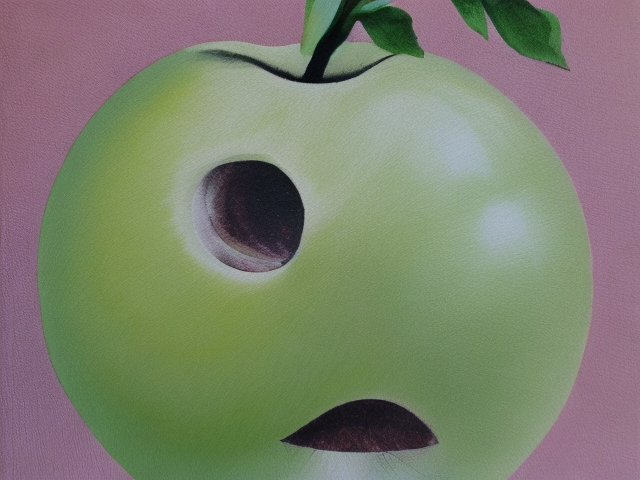

In [10]:
text2image_prompt_merging(prompt1="apfel", prompt2="auge", mix_factor=0.6, num_inference_steps=20)

### Stable Diffusion Prompt Interpolation

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

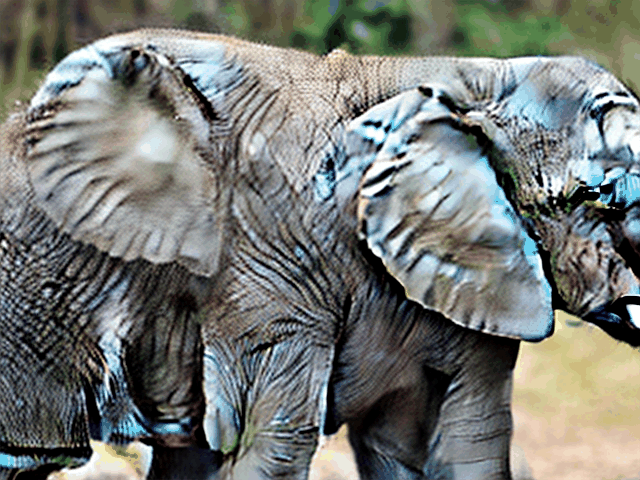

In [4]:
generated_image, gif_path = text2image_prompt_interpolation(prompt1="An octopus", prompt2="An elephant", num_interpolation_steps=30, num_inference_steps=10)
Image(filename=gif_path)

# Zusatzmaterial

### Walking through latent space

  0%|          | 0/35 [00:00<?, ?it/s]

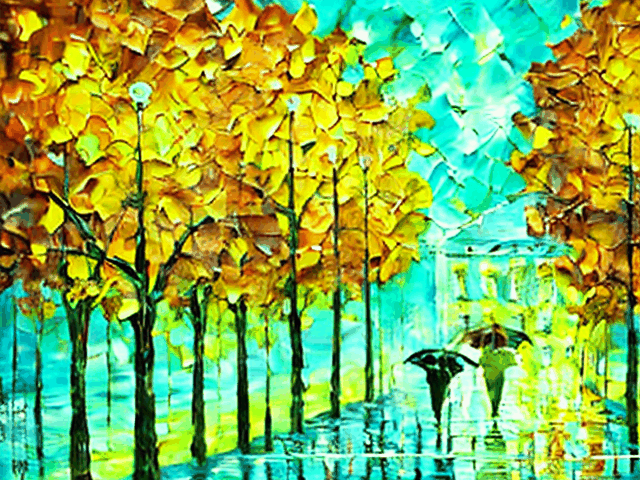

In [4]:
generated_image, gif_path = text2image_latent_walk_image("Palette knife painting of an autumn cityscape", num_inference_steps=35)
DisplayImage(filename=gif_path)

### Walking through prompt space

  0%|          | 0/35 [00:00<?, ?it/s]

  0%|          | 0/35 [00:00<?, ?it/s]

  0%|          | 0/35 [00:00<?, ?it/s]

  0%|          | 0/35 [00:00<?, ?it/s]

  0%|          | 0/35 [00:00<?, ?it/s]

  0%|          | 0/35 [00:00<?, ?it/s]

  0%|          | 0/35 [00:00<?, ?it/s]

  0%|          | 0/35 [00:00<?, ?it/s]

  0%|          | 0/35 [00:00<?, ?it/s]

  0%|          | 0/35 [00:00<?, ?it/s]

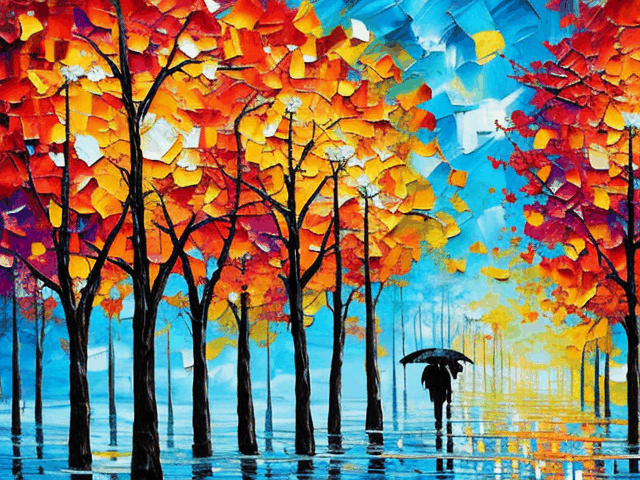

In [5]:
generated_image, gif_path = text2image_latent_walk_prompt("Palette knife painting of an autumn cityscape")
DisplayImage(filename=gif_path)